#Section A

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2 as cv
from google.colab.patches import cv2_imshow
import numpy as np

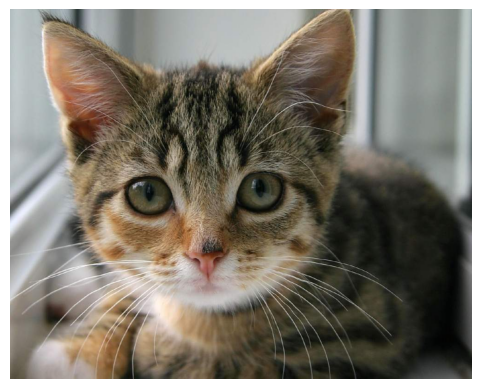

In [ ]:
img1 = mpimg.imread("Image1.jpeg")
plt.imshow(img1)
plt.axis('off')
plt.show()

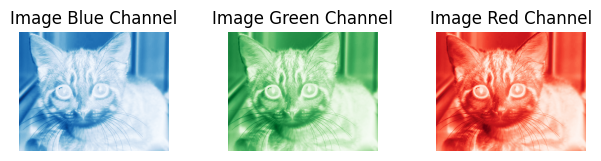

In [ ]:
img1 = cv.imread("Image1.jpeg")
#split image
plt.figure(figsize=(10, 5))
BluePart, GreenPart, RedPart = cv.split(img1)
#first channel
plt.subplot(1, 4, 4)
plt.imshow(RedPart, cmap='Reds')
plt.title('Image Red Channel')
plt.axis('off')
#second channel
plt.subplot(1, 4, 3)
plt.imshow(GreenPart , cmap='Greens')
plt.title('Image Green Channel')
plt.axis('off')
#third channel
plt.subplot(1, 4, 2)
plt.imshow(BluePart, cmap='Blues')
plt.title('Image Blue Channel')
plt.axis('off')

#put some spaces between each pic so the titles don't overlap
plt.subplots_adjust(wspace=0.4)
plt.show()

For conveting an RGB image without using the existing functions, we have to apply this formula for each of the pixels of our image:

 Grey = 0.299 * Red + 0.587 * Blue + 0.114 * Green



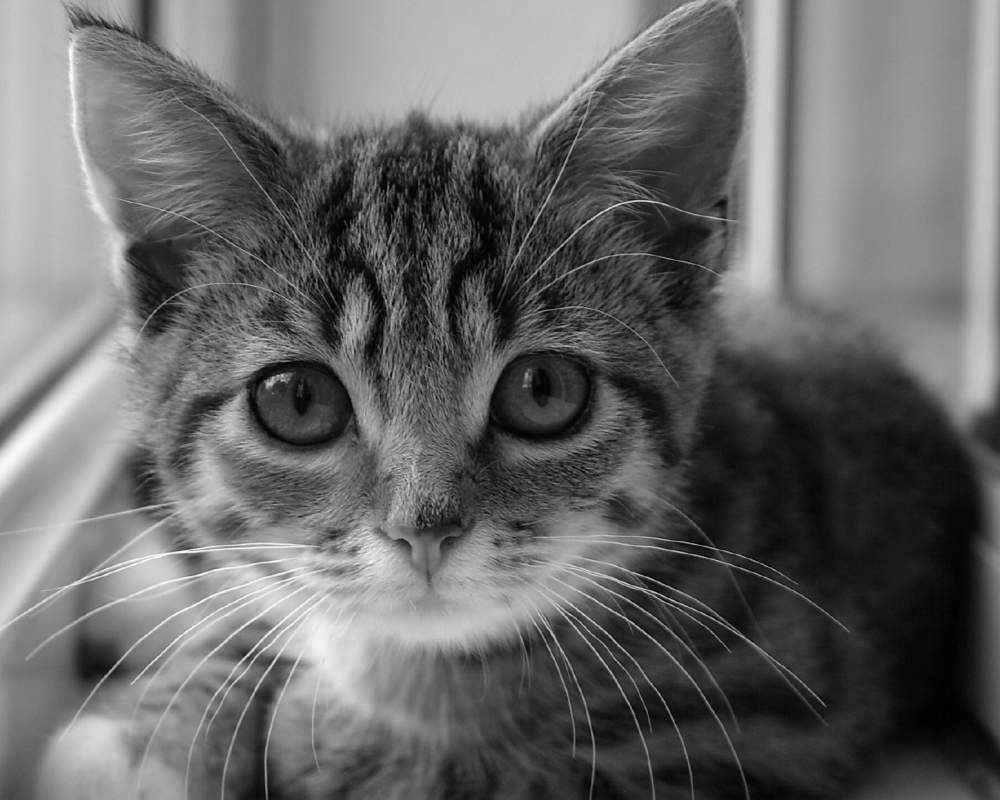

In [ ]:
rows = img1.shape[0]
columns = img1.shape[1]
for row in range(rows):
  for col in range(columns):
    img1[row,col] = 0.299 * img1[row,col,2] + 0.587 * img1[row,col,0] + 0.114 * img1[row,col,1]
#see the result
cv2_imshow(img1)

For converting our image from RGB to HSV we need to use the conversion formulas:




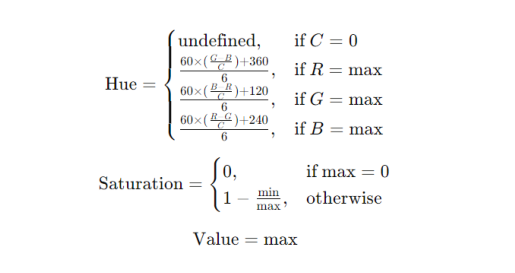

In [ ]:
hsv = mpimg.imread('/content/hsv.png')
plt.imshow(hsv)
plt.axis('off')
plt.show()

In [ ]:
img1 = cv.imread("Image1.jpeg")
img_hsv = np.zeros_like(img1, dtype=np.float32)

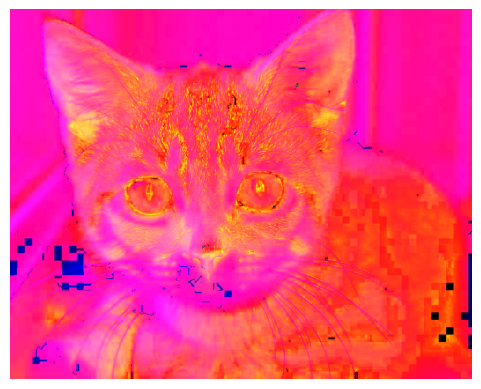

In [ ]:
for row in range(rows):
  for col in range(columns):
    red = img1[row,col,2]/255.0
    green = img1[row,col,1]/255.0
    blue = img1[row,col,0]/255.0
    dlta = max(red,green,blue) - min(red,green,blue)
    value = max(red,green,blue)
    if (dlta == 0) :
      hue = 0
    elif(value == red):
      diff = green - blue
      hue = 60 * ((diff/dlta) % 6)
    elif(value == green):
      diff = blue - red
      hue = 60 * ((diff/dlta) + 2)
    elif( value == blue):
      diff = red - green
      hue = 60 * ((diff/dlta) + 4)
    if max(red,green,blue) == 0 :
      saturation = 0
    else :
      saturation = (1 - (min(green,red,blue)/max(green,red,blue)))

    img_hsv[row,col] = [hue,saturation,value]

plt.imshow(img_hsv)
plt.axis('off')
plt.show()


Converting to hsv using built-in functions

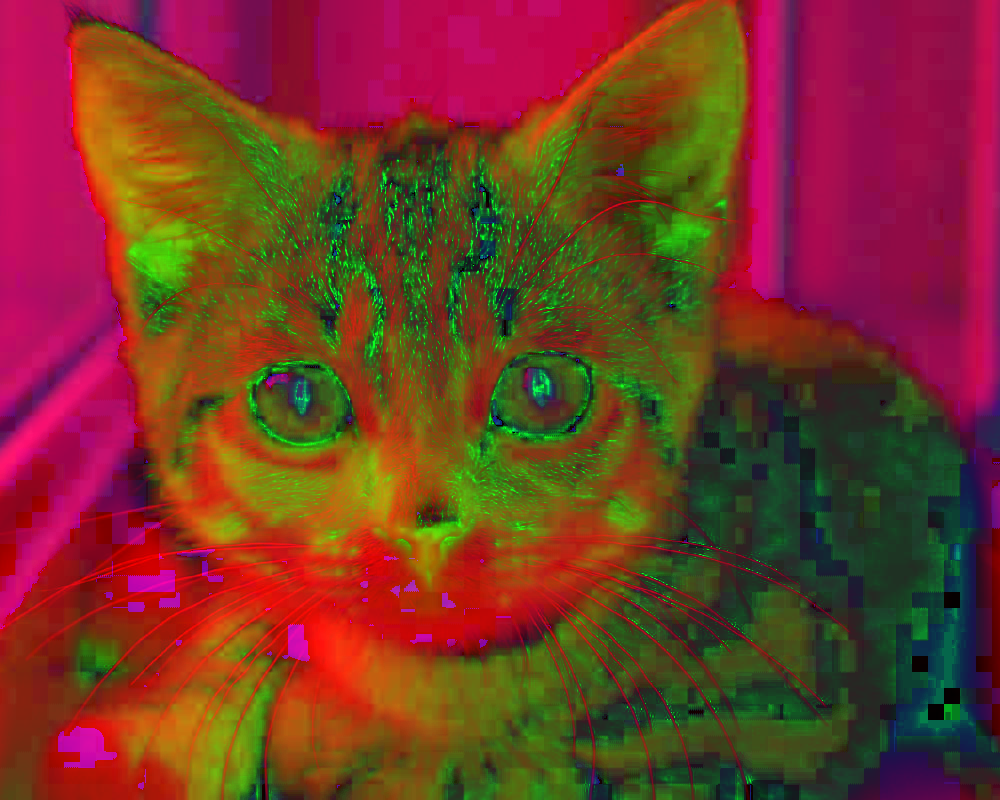

In [ ]:
hsv = cv.cvtColor(img1,cv.COLOR_BGR2HSV)
cv2_imshow(hsv)

Since we are extracting the red color from our image, we should consider the ranges of red. Red has two different ranges due to the fact that it wraps around the hue range.

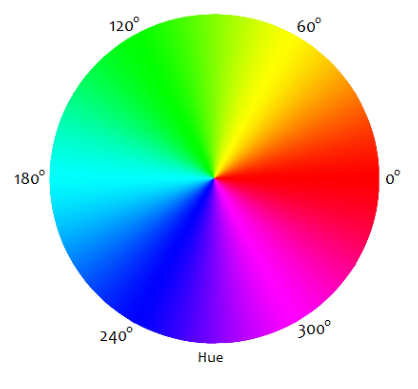

In [ ]:
image = mpimg.imread('/content/hsv_red.png')
plt.imshow(image)
plt.axis('off')
plt.show()

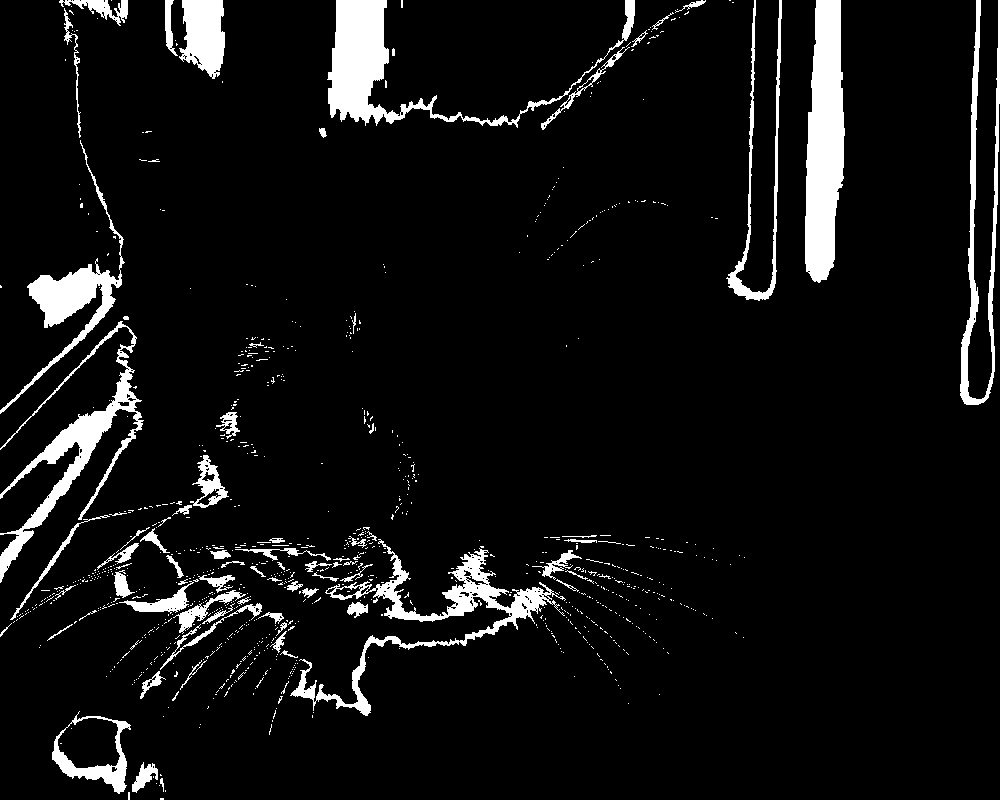

In [ ]:
lower_red_1 = np.array([0, 100, 100])
upper_red_1 = np.array([10, 255, 255])
lower_red_2 = np.array([160, 100, 100])
upper_red_2= np.array([179, 255, 255])
red1 = cv.inRange(img1, lower_red_1, upper_red_1)
red2 = cv.inRange(img1, lower_red_2, upper_red_2)
Red_Merged = cv.bitwise_or(red1, red2)
cv2_imshow(Red_Merged)

#Section B

In [ ]:
img2_1 = cv.imread("/content/Image2.1.jpg")
img2_2 = cv.imread("/content/Image2.2.jpg")

In [ ]:
img2_1 = cv.cvtColor(img2_1,cv.COLOR_BGR2GRAY)
img2_2 = cv.cvtColor(img2_2,cv.COLOR_BGR2GRAY)

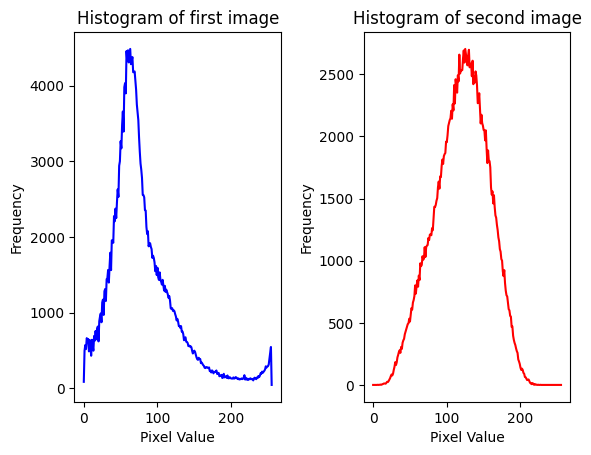

In [ ]:
hist_plot1 = cv.calcHist([img2_1], [0], None, [256], [0, 256])
hist_plot2 = cv.calcHist([img2_2], [0], None, [256], [0, 256])

plt.subplot(1, 2, 1)
plt.plot(hist_plot1, color='b')
plt.title('Histogram of first image')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
plt.plot(hist_plot2, color='r')
plt.title('Histogram of second image')
plt.xlabel('Pixel Value')
plt.ylabel('Frequency')

plt.subplots_adjust(wspace=0.4)
plt.show()

In [ ]:
cum_dist1 = hist_plot1.cumsum()
cum_dist2 = hist_plot2.cumsum()
transfer_function = np.interp(cum_dist1, cum_dist2, range(256))
transformed_img = cv.LUT(img2_1, transfer_function.astype(np.uint8))

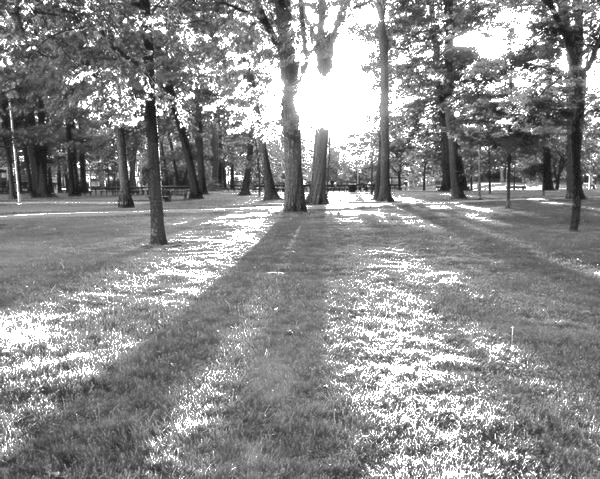

In [ ]:
cv2_imshow(transformed_img)

#Section C

In [ ]:
img3 = cv.imread("/content/Image3.jpg")

In [ ]:
img3 = cv.cvtColor(img3,cv.COLOR_BGR2GRAY)

In [ ]:
#Applying all of the wanted filters
#first filter : 2 times 3 *3 median
img3_1 = cv.blur(img3, (3, 3))
img3_1 = cv.blur(img3_1, (3, 3))
#second filter : 9 * 9 median
img3_2 = cv.blur(img3, (9, 9))
#third filter
img3_3 = cv.GaussianBlur(img3, (5, 5), 0)

In [ ]:
#Plotting the Histograms
hist_filter0 = cv.calcHist([img3], [0], None, [256], [0, 256])
hist_filter1 = cv.calcHist([img3_1], [0], None, [256], [0, 256])
hist_filter2 = cv.calcHist([img3_2], [0], None, [256], [0, 256])
hist_filter3 = cv.calcHist([img3_3], [0], None, [256], [0, 256])

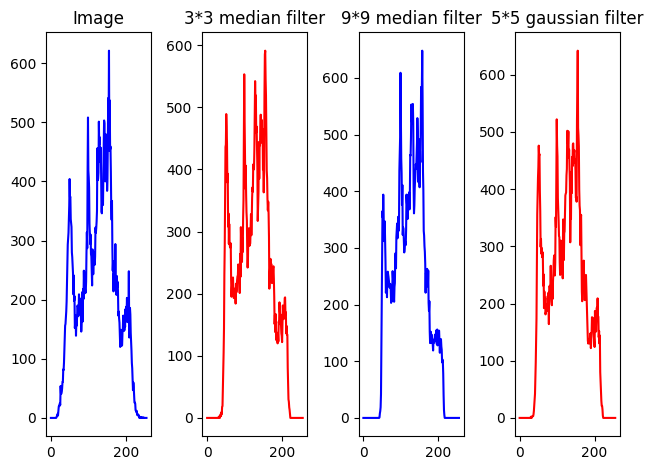

In [ ]:
plt.subplot(1, 4, 1)
plt.plot(hist_filter0, color='b')
plt.title('Image')

plt.subplot(1, 4, 2)
plt.plot(hist_filter1, color='r')
plt.title('3*3 median filter')

plt.subplot(1, 4, 3)
plt.plot(hist_filter2, color='b')
plt.title('9*9 median filter')

plt.subplot(1, 4, 4)
plt.plot(hist_filter3, color='r')
plt.title('5*5 gaussian filter')

plt.subplots_adjust(wspace=0.5)
plt.tight_layout()
plt.show()

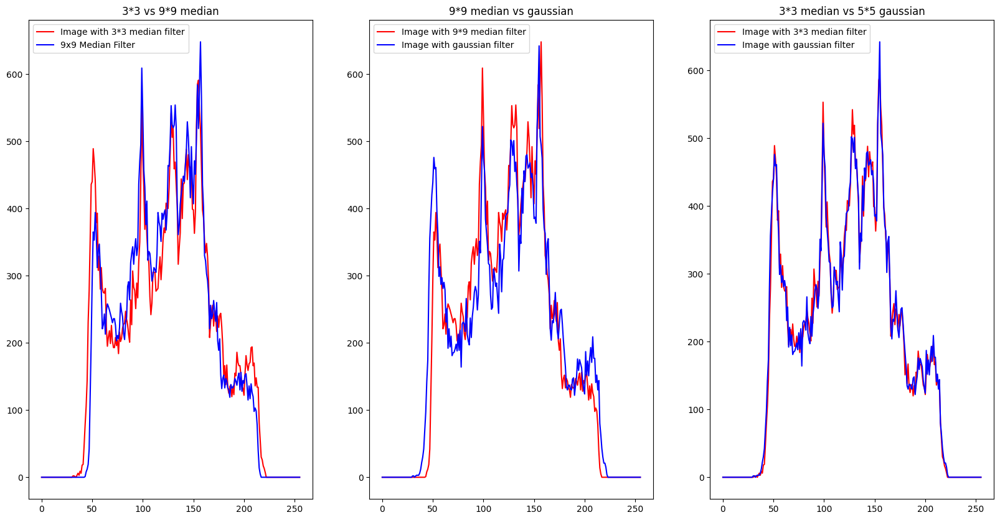

In [ ]:
plt.figure(figsize=(20,10))
plt.subplot(1, 3, 1)
plt.plot(hist_filter1, color='r')
plt.plot(hist_filter2, color='b')
plt.title('3*3 vs 9*9 median')
plt.legend(['Image with 3*3 median filter', '9x9 Median Filter'])

plt.subplot(1, 3, 2)
plt.plot(hist_filter2, color='r')
plt.plot(hist_filter3, color='b')
plt.title('9*9 median vs gaussian')
plt.legend(['Image with 9*9 median filter', 'Image with gaussian filter'])

plt.subplot(1, 3, 3)
plt.plot(hist_filter1, color='r')
plt.plot(hist_filter3, color='b')
plt.title('3*3 median vs 5*5 gaussian')
plt.legend(['Image with 3*3 median filter', 'Image with gaussian filter'])



Though it may seem that applying 3x3 median filter twice would do the same thing as 9*9 median filter, it's not true. Applying 3x3 filter twice leads to losing more information than just using the 9x9 median once.

twice of the 3x3 filter gives quite the same result as 5x5 gaussian filter although the 5x5 gaussian filter removes less details from image.

In [ ]:
filter1_filter2 = np.mean((img3_1 - img3_2) ** 2)
filter1_filter3 = np.mean((img3_1 - img3_3) ** 2)
rslt_filter1_filter2 = 10 * np.log10((255 ** 2) / filter1_filter2)
rslt_filter1_filter3 = 10 * np.log10((255 ** 2) / filter1_filter3)

In [ ]:
print("PSNR for the image after applying the first(2 times 3x3) and second(9x9) filters is : " , rslt_filter1_filter2)
print("PSNR for the image after applying the first(2 times 3x3) and third(5x5 gaussian) filters is: ", rslt_filter1_filter3)

PSNR for the image after applying the first(2 times 3x3) and second(9x9) filters is :  31.751812626908062
PSNR for the image after applying the first(2 times 3x3) and third(5x5 gaussian) filters is:  43.34272390513907


#Section D

In [ ]:
img4 = cv.imread("/content/Image4.jpeg")

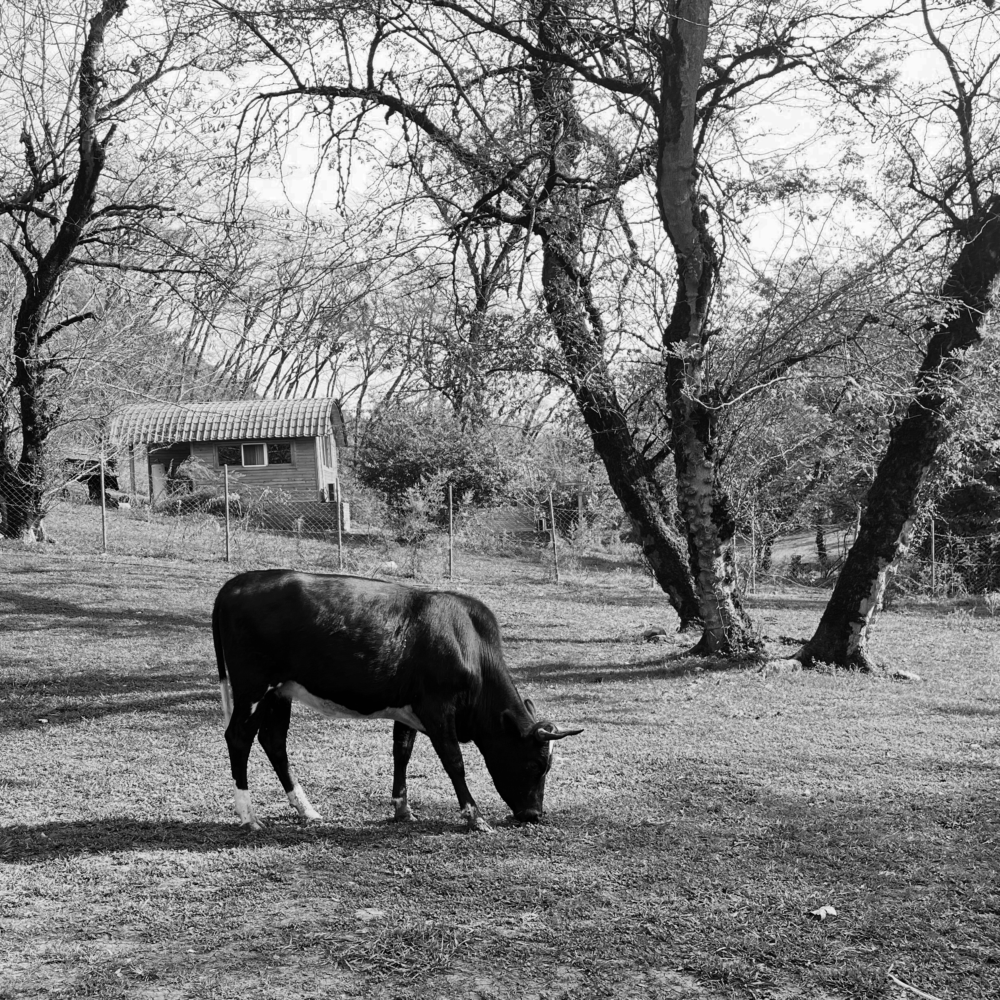

In [ ]:
histogram, _ = np.histogram(img4.flatten(), bins=256, range=(0, 256))
cdf = histogram.cumsum()
cdf_normalized = cdf / cdf.max()
mapping = (255 * cdf_normalized).astype('uint8')
eq_img = mapping[img4]
cv2_imshow(eq_img)

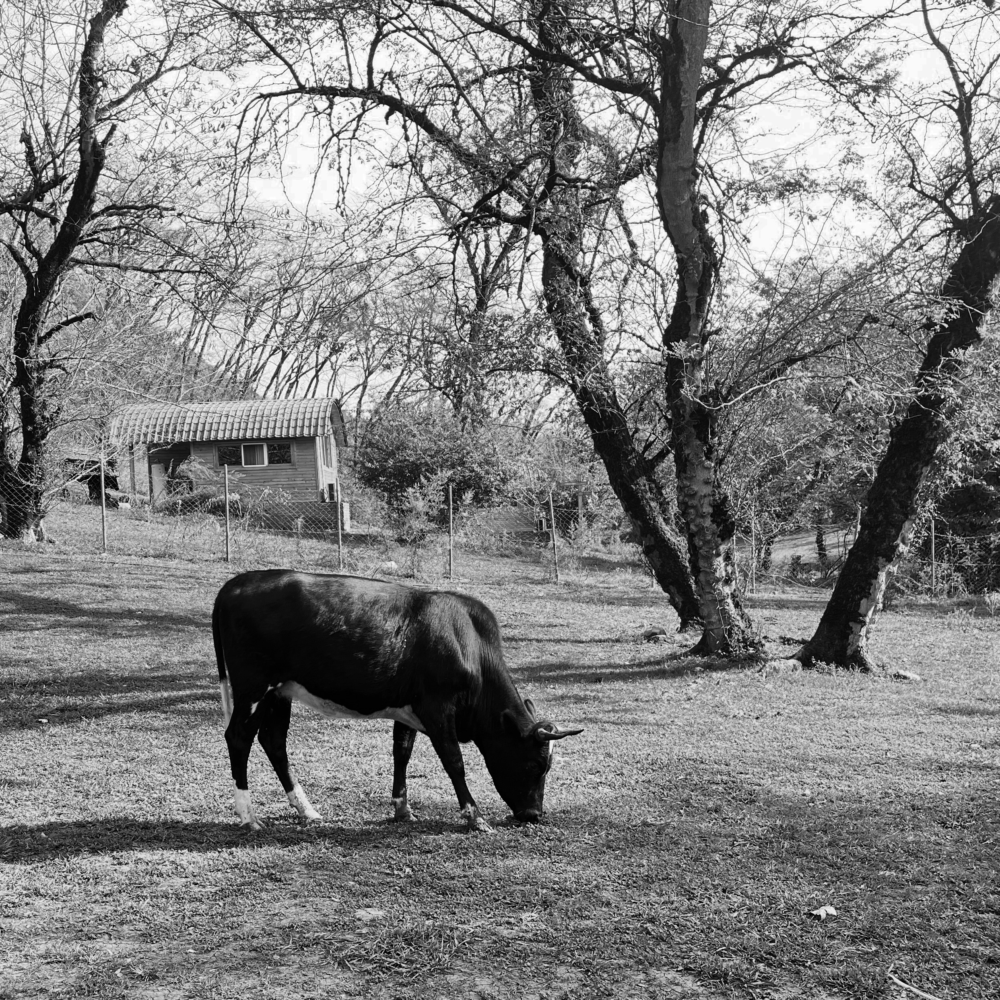

In [ ]:
img4 = cv.cvtColor(img4, cv.COLOR_BGR2GRAY)
eq_img2= cv.equalizeHist(img4)
cv2_imshow(eq_img2)

In [ ]:
hist1 = cv.calcHist([eq_img], [0], None, [256], [0, 256])
hist2 = cv.calcHist([eq_img2], [0], None, [256], [0, 256])

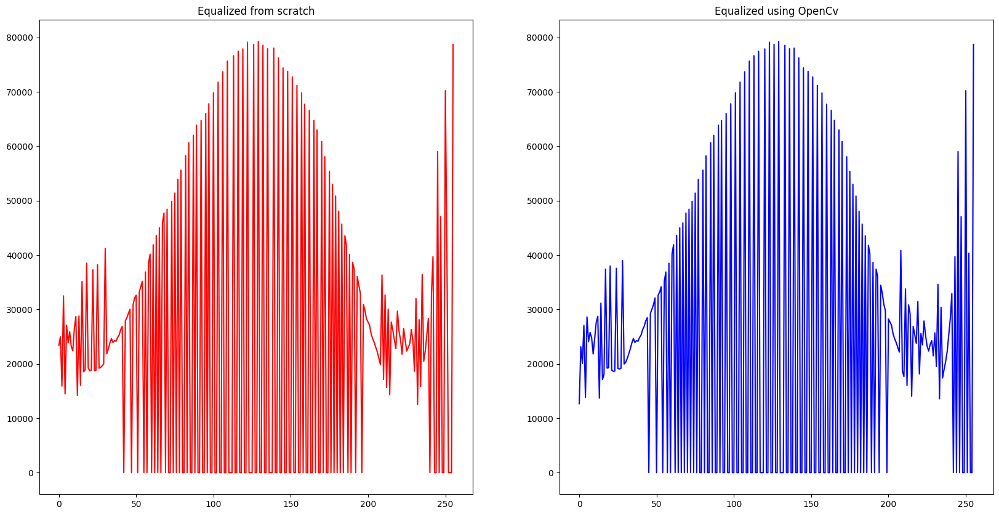

In [ ]:
plt.figure(figsize=(20,10))
plt.subplot(1, 2, 1)
plt.plot(hist1,color='r')
plt.title("Equalized from scratch")

plt.subplot(1,2,2)
plt.plot(hist2,color='b')
plt.title("Equalized using OpenCv")

plt.show()


#Section E

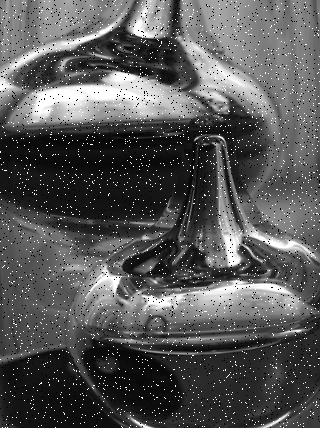

In [ ]:
img5 = cv.imread("/content/Image5.jpg")
cv2_imshow(img5)

For this kind of noise which is called "salt and pepper noise" , the best way to remove noise is using median filter.  This method defines a neighbourhood for each pixel and then computes the median pixel value in the chosen pixel's neighbourhood.Finally, it replaces the pixel value with the median of its neighbourhood.

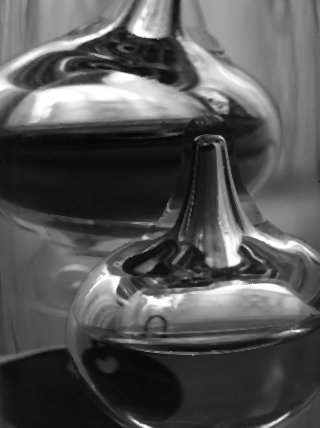

In [ ]:
denoised_image = cv.medianBlur(img5, 3)
cv2_imshow(denoised_image)

#Section F

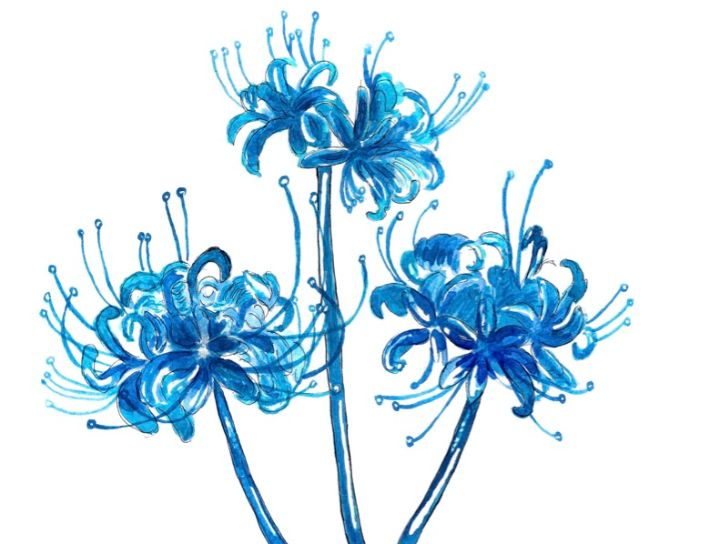

In [ ]:
img6 = cv.imread("/content/Q6_image_original.jpg")
cv2_imshow(img6)

In [ ]:
blr_img6 = cv.GaussianBlur(img6, (15, 15), 0)
result = cv.addWeighted(img6, 2, blr_img6, -1, 0)

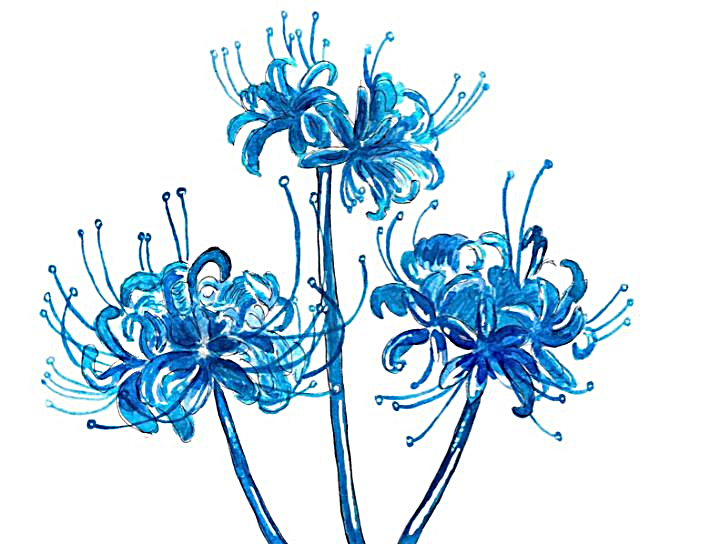

In [ ]:
result = cv.addWeighted(img6, 2, blr_img6, -1, 0)
cv2_imshow(result)

In [ ]:
img6 = cv.cvtColor(img6, cv.COLOR_BGR2RGB)
blr_img6 = cv.cvtColor(blr_img6, cv.COLOR_BGR2RGB)
result = cv.cvtColor(result, cv.COLOR_BGR2RGB)

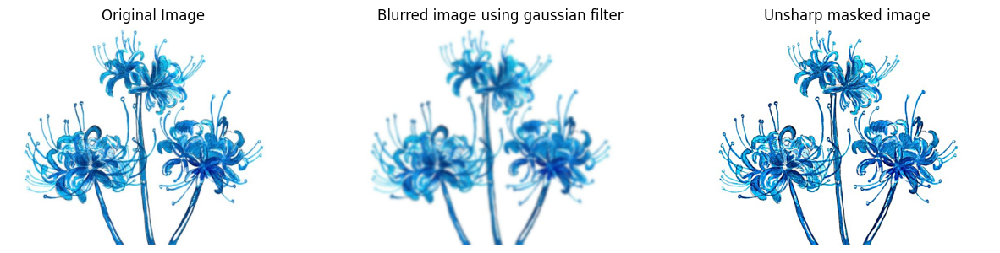

In [ ]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(img6)
plt.title('Original Image')
plt.axis('off')


plt.subplot(1, 3, 2)
plt.imshow(blr_img6)
plt.title('Blurred image using gaussian filter')
plt.axis('off')


plt.subplot(1, 3, 3)
plt.imshow(result)
plt.title('Unsharp masked image')
plt.axis('off')


plt.show()